# An applied facility location problem: Transient Ischaemic Attack (TIA) clinics in Cornwall, UK <br/><br/>

## Executive Summary <br/>

Finding the optimal location for service facilities for a spatially distributed demand is an important research topic in the area of location planning. This 'facility location problem' dates back to Alfred Weber (1909) for the problem of locating a single warehouse. The only optimization criterion used was the minimization of the weighted sum of distances from a given set of areas, known as the Weber problem. In the case of TIA, time constraints
are critical in the recovery of the patient, in order to avoid irreversible sequellae. On this basis, we were asked to conduct a study of the reorganization of the clinic locations in the Cornwall sub-region. In other words, the general aim of this study was to restrict the five TIA clinics existing in this sub-region to three while ensuring fair and effective access for its population, guaranteed by a seven-day opening of those.
The analyses first showed that, amongst these five clinics, not all could ensure equitable access to care, as a result of travel time that might be aggravated by the closure of some of them. Then, by identifying the combination of three of those five clinics with the lowest standard deviation of the weighted average travel time, we managed to obtain three locations (Bodmin, RCHT, WCH)  assuring relatively fast and equitable access to care for patients from this sub-region with TIA symptoms, whilst taking into account of the most deprived LSOAs. Hence, we believed that these findings could be valuable support for the NHS team makers. <br/><br/>

## Aims <br/>

This study first aimed to reveal the unfairness in clinic access for the patients living in this sub-region, explained by the travel burden, and reinforced by the daily closure of some of the clinics. Then, in view of these disparities, and of the involved operating costs of five clinics, we aimed to find a set of three of the five existing TIA clinics able to ensure efficient and fair access for all patients, secured by a seven-day opening of those. <br/><br/>

## Planned Analysis <br/>

We first conducted a historical analysis of TIA clinic demand, to determine the total number of admissions in each clinic as well as whether study patients were always able or not to visit their nearest clinic location. Later, we investigated the car travel time from the different areas to the five facilities. To that end, we grouped the LSOAs by their nearest facility to calculate their average travel time to their closest clinic, weighted by their total demand. With the same approach, we got the maximum and 95th percentile travel time to each clinic. Then, we created an interactive map centered on the Cornwall region using the Folium package. In that way, we were able to display the total demand per LSOA (non-normalized and normalized), as well as their car travel time to their nearest clinic. In the last section, we created a function returning a DataFrame storing the weighted average travel time to each clinic from each possible combination of three clinics. In that way, we evaluated those various combinations based on the standard deviation of their weighted average travel time. Finally, adding a base map using the contextily package, we explored geographically the IMD across this sub-region to ensure that the most deprived areas were not disadvantaged by these service changes. <br/><br/>

In [1]:
# import the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as ctx
import folium
from folium.plugins import MarkerCluster
from folium.features import DivIcon
from IPython.display import display_html
import itertools
import functools


## <br/> 1. Historical Analysis <br/>

In [2]:
# load historical demand data into Pandas DataFrame
tia_referrals = pd.read_csv('tia_referrals.csv')
tia_referrals.head()


,patient_id,location_attended,local_clinic,LSOA11CD,LSOA11NM
0,1,RCHT,Bodmin,E01018936,Cornwall 001A
1,2,RCHT,RCHT,E01018806,Cornwall 063D
2,3,RCHT,CRCH,E01018861,Cornwall 072A
3,4,RCHT,RCHT,E01018817,Cornwall 047B
4,5,RCHT,Bodmin,E01018936,Cornwall 001A


In [3]:
# store the number of referrals to each clinic into Pandas DataFrame
n_referrals = pd.DataFrame(tia_referrals["location_attended"].value_counts())
n_referrals


,location_attended
RCHT,619
CRCH,293
SACH,289
BODMIN,249
WCH,223


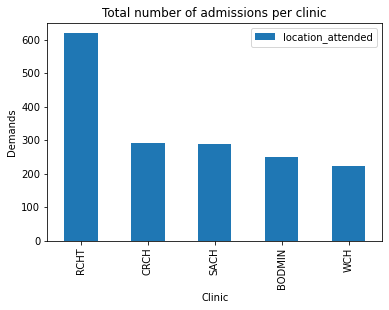

In [4]:
# visualize it with a barplot
ax = n_referrals.plot(kind="bar")
ax.set_xlabel('Clinic')
ax.set_ylabel('Demands')
ax.set_title('Total number of admissions per clinic')
text = ax.text(0.5, 0.96, '')
text.remove()


<br/> This bar plot (supported by the raw figures) indicated clearly that the demand for the RCHT clinic in this Cornwall sub-region was predominant over the other clinics, suggesting that this facility was much more open than the others, or/and could be geographically the best positioned in this Cornwall sub-region in terms of access travel time or population size living nearby this clinic.   <br/><br/>

In [5]:
# count attendances/nearest attendances for each clinic
a_near = tia_referrals.groupby(by=['location_attended', 'local_clinic']).size()

# convert into a Pandas DataFrame and assign a new column name
a_near = pd.DataFrame(a_near)
a_near.columns = ["Patient_count"]

# slice the rows for the first two clinics
a_near1 = a_near.loc[('BODMIN', 'Bodmin'):('CRCH', 'WCH')]

# slice the rows for the last two clinics
a_near2 = a_near.loc[('RCHT', 'Bodmin'):('WCH', 'WCH')]


# print out both df in stylized HTML format
styles = [dict(
               selector="caption",
               props=[("text-align", "center"),
                      ("font-size", "130%"),
                      ("color", 'black')])]

space = "&nbsp;&nbsp;&nbsp;&emsp;&emsp;&emsp;"
styler_1 = a_near1.style.set_table_attributes("style='display:inline'")
styler_1.set_table_styles(styles)
styler_2 = a_near2.style.set_table_attributes("style='display:inline'")
styler_2.set_table_styles(styles)
display_html(styler_1._repr_html_() + space +
             styler_2._repr_html_(), raw=True)


Patient_count 
 
 
 location_attended 
 local_clinic 
   
 
 
 
 
 BODMIN 
 Bodmin 
 107 
 
 
 CRCH 
 45 
 
 
 RCHT 
 43 
 
 
 SACH 
 46 
 
 
 WCH 
 8 
 
 
 CRCH 
 Bodmin 
 18 
 
 
 CRCH 
 142 
 
 
 RCHT 
 68 
 
 
 SACH 
 28 
 
 
 WCH 
 37 
 
 
 
      
 
 
 
   
   
 Patient_count 
 
 
 location_attended 
 local_clinic 
   
 
 
 
 
 RCHT 
 Bodmin 
 78 
 
 
 CRCH 
 170 
 
 
 RCHT 
 228 
 
 
 SACH 
 78 
 
 
 WCH 
 65 
 
 
 SACH 
 Bodmin 
 63 
 
 
 CRCH 
 40 
 
 
 RCHT 
 69 
 
 
 SACH 
 100 
 
 
 WCH 
 17 
 
 
 WCH 
 Bodmin 
 11 
 
 
 CRCH 
 84 
 
 
 RCHT 
 41 
 
 
 SACH 
 13 
 
 
 WCH 
 74

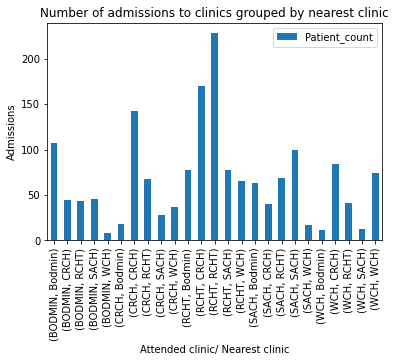

In [6]:
# visualize it with a barplot
ax = a_near.plot(kind='bar')
ax.set_xlabel('Attended clinic/ Nearest clinic')
ax.set_ylabel('Admissions')
ax.set_title('Number of admissions to clinics grouped by nearest clinic')
text = ax.text(0.5, 0.96, '')
text.remove()


<br/> Due to the constraints imposed by the daily clinic closing days, there were patients which were not able to reach their nearest clinic, in support of inequitable clinic access between all the patients. TIA symptoms are very severe and patients need therefore fast and equitable access to care. <br/><br/>

## 2. TIA clinics accessibility and travel time inequalities <br/>

### 2.1. Data Analysis <br/><br/>

In [7]:
# store the TIA clinic demand per area into Pandas DataFrame
LSOA_demands = tia_referrals.groupby(by="LSOA11CD")["patient_id"].count()
LSOA_demands = pd.DataFrame(LSOA_demands)

# reset index to a new sequential index and assign new column names
LSOA_demands = LSOA_demands.reset_index()
LSOA_demands.columns = ["LSOA11CD", "admissions"]
LSOA_demands.head()


,LSOA11CD,admissions
0,E01018757,3
1,E01018758,10
2,E01018761,19
3,E01018763,2
4,E01018768,6


In [8]:
# load the car travel time data into Pandas DataFrame
travel_matrix = pd.read_csv('travel_matrix.csv')
travel_matrix.head()


,LSOA11CD,PL266AA,PL312QT,TR13LQ,TR153ER,TR182PF
0,E01018750,40,31,60,66,87
1,E01018751,40,31,60,66,87
2,E01018752,41,32,61,67,88
3,E01018753,43,34,64,69,90
4,E01018754,46,38,67,72,93


In [9]:
# merge the LSOA demand for clinics df with the travel time df into a single df
demand_TT = LSOA_demands.merge(travel_matrix, on="LSOA11CD", how="inner")

# assign a new column storing the time to nearest clinic for each LSOA
demand_TT["min_travel_time"] = demand_TT[demand_TT.columns[2:]].min(axis=1)

# assign a new column storing the closest clinic for each LSOA
demand_TT["nearest_facility"] = demand_TT[demand_TT.columns[2:]].idxmin(axis=1)

# restrict the df
mask = ['LSOA11CD', 'admissions', 'min_travel_time', 'nearest_facility']
demand_TT = demand_TT[mask]
demand_TT.head()


,LSOA11CD,admissions,min_travel_time,nearest_facility
0,E01018757,3,34,PL312QT
1,E01018758,10,16,PL312QT
2,E01018761,19,26,PL312QT
3,E01018763,2,31,PL312QT
4,E01018768,6,22,PL312QT


In [10]:
# get the weighted average travel time by grouping by nearest facility
# record it into DataFrame
wat = demand_TT.groupby(by='nearest_facility').apply(lambda x:
                                                     np.average(
                                                         x.min_travel_time,
                                                         weights=x.admissions))
wat = pd.DataFrame(wat).reset_index()
wat.columns = ['nearest_facility', 'Weighted_Average_TT']

# get the maximum travel time by grouping by nearest facility
# record it into DataFrame
max_TT = demand_TT.groupby('nearest_facility')['min_travel_time'].max()
max_TT = pd.DataFrame(max_TT).reset_index()
max_TT.columns = ['nearest_facility', 'max_TT']

# link up the average and maximum travel time dfs
wat_max = wat.merge(max_TT, on='nearest_facility', how='inner')

# get the 95th percentile by grouping by nearest facility
# record it into DataFrame
Q = demand_TT.groupby('nearest_facility')['min_travel_time'].quantile(0.95)
Q = pd.DataFrame(Q).reset_index()
Q.columns = ['nearest_facility', '95Q_TT']

# link up the average, maximum, and 95th percentile dfs
wa_max_Q = wat_max.merge(Q, on='nearest_facility', how='inner')
wa_max_Q


,nearest_facility,Weighted_Average_TT,max_TT,95Q_TT
0,PL266AA,7.703540,21,17.85
1,PL312QT,15.068862,41,39.50
2,TR13LQ,10.965870,21,21.00
3,TR153ER,10.478559,31,28.00
4,TR182PF,7.978903,17,16.35


<br/> This table reflected the inequitable travel-time distance between the LSOAs and their respective nearest clinic location. While the clinic with postcode PL312QT was the most difficult to access for its patients according to the above metrics, it deepened the disparities in terms of LSOA-clinic distance. <br/> <br/>

### 2.2. Geospatial Analysis - Visualisation <br/><br/>

In [11]:
# fetch the south west data from a remote github repo
url = 'https://raw.githubusercontent.com/health-data-science-OR/' \
        + 'healthcare-logistics/master/mapping/data/devon_cornwall.zip'

# load LSOA data from south west region into Geopandas DataFrame
south_west = gpd.read_file(url)

# call the sub region Cornwall data and store it into new df
region = "Cornwall"
cornwall = south_west[south_west["LSOA11NM"].str.contains(region)]
cornwall.head()


,OBJECTID,LSOA11CD,LSOA11NM,LSOA11NMW,Shape__Area,Shape__Length,geometry
248,18214,E01018750,Cornwall 013A,Cornwall 013A,1.747044e+06,8659.881836,"POLYGON ((-4.32335 50.50157, -4.32331 50.50159..."
249,18215,E01018751,Cornwall 013B,Cornwall 013B,6.307371e+06,24974.221891,"POLYGON ((-4.31404 50.50482, -4.31400 50.50487..."
250,18216,E01018752,Cornwall 013C,Cornwall 013C,3.281509e+06,10746.007184,"POLYGON ((-4.31120 50.50815, -4.31294 50.50786..."
251,18217,E01018753,Cornwall 010A,Cornwall 010A,1.155167e+07,19291.827874,"POLYGON ((-4.27129 50.51834, -4.27132 50.51841..."
252,18218,E01018754,Cornwall 010B,Cornwall 010B,2.345915e+06,12718.470039,"POLYGON ((-4.22537 50.51687, -4.22535 50.51685..."


In [12]:
# load clinic data into GeoPandas DataFrame
tia_clinics = gpd.read_file('tia_clinics.csv')

# set geometry
tia_clinics.geometry = gpd.points_from_xy(tia_clinics.long, tia_clinics.lat)

# set crs for geometry, using epsg=4326 for lat/long
tia_clinics = tia_clinics.set_crs(epsg=4326)
tia_clinics.head()


,Clinic,postcode,lat,long,geometry
0,BODMIN,PL31 2QT,50.46754,-4.74115,POINT (-4.74115 50.46754)
1,RCHT,TR1 3LQ,50.26656,-5.09426,POINT (-5.09426 50.26656)
2,CRCH,TR15 3ER,50.22938,-5.24438,POINT (-5.24438 50.22938)
3,SACH,PL26 6AA,50.32714,-4.77305,POINT (-4.77305 50.32714)
4,WCH,TR18 2PF,50.12205,-5.54298,POINT (-5.54298 50.12205)


In [13]:
# fetch the population estimates data from a remote github repo
url = 'https://raw.githubusercontent.com/health-data-science-OR/' \
    + 'healthcare-logistics/master/mapping/data/mid-2017-lsoa-pop-estimates.zip'

# read this data into df
pop = pd.read_csv(url)

# filter columns so we don't merge all fields
pop = pop[['Area Codes', 'All Ages']]

# rename for merge
pop.columns = ['LSOA11CD', 'N']

# drop any rows with NA (these are total fields for an area).
pop = pop[pop['LSOA11CD'].notna()]


# merge the LSOA clinic demand (with TT) with the pop df
demand_TT = demand_TT.merge(pop, on='LSOA11CD', how='inner')

# calculate the rate per 1000 of population
demand_TT['admits_per_1k'] = demand_TT['admissions'] / (demand_TT['N'] / 1000)
demand_TT.head()


,LSOA11CD,admissions,min_travel_time,nearest_facility,N,admits_per_1k
0,E01018757,3,34,PL312QT,2146,1.397950
1,E01018758,10,16,PL312QT,2600,3.846154
2,E01018761,19,26,PL312QT,1535,12.377850
3,E01018763,2,31,PL312QT,1117,1.790510
4,E01018768,6,22,PL312QT,2068,2.901354


In [26]:
# merge the Cornwall sub region gdf with the demand_TT df into single gdf
cornwall2 = cornwall.merge(demand_TT, on="LSOA11CD", how="inner")

# create base map
tiles = 'stamenterrain'
TIA_map = folium.Map([50.503632, -4.652498], zoom_start=9, tiles=tiles)

# filter data to display
fields = ['LSOA11NM', 'admissions', 'admits_per_1k', 'min_travel_time']
lsoa_tia = cornwall2[fields]
field_index = [1, 2, 3]

# create and add choropleth map
choropleth = folium.Choropleth(
    # pass the GeoDataFrame
    geo_data=cornwall2,
    # data for overlaying
    data=lsoa_tia,
    # columns = [key, field to plot]
    columns=['LSOA11NM', fields[field_index[0]]],
    key_on='feature.properties.LSOA11NM',
    # choose the fill colour
    fill_color='GnBu',
    # set the legent name
    legend_name=fields[field_index[0]],
    # highlight the LSOA shape when mouse pointer enters it
    highlight=True,
    smooth_factor=0).add_to(TIA_map)

# create and add choropleth map
choropleth = folium.Choropleth(
    # pass the GeoDataFrame
    geo_data=cornwall2,
    # data for overlaying
    data=lsoa_tia,
    # columns = [key, field to plot]
    columns=['LSOA11NM', fields[field_index[1]]],
    key_on='feature.properties.LSOA11NM',
    # choose the fill colour
    fill_color='PuRd',
    # set the legent name
    legend_name=fields[field_index[1]],
    # highlight the LSOA shape when mouse pointer enters it
    highlight=True,
    smooth_factor=0).add_to(TIA_map)

# create and add choropleth map
choropleth = folium.Choropleth(
    # pass the GeoDataFrame
    geo_data=cornwall2,
    # data for overlaying
    data=lsoa_tia,
    # columns = [key, field to plot]
    columns=['LSOA11NM', fields[field_index[2]]],
    key_on='feature.properties.LSOA11NM',
    # choose the fill colour
    fill_color='OrRd',
    # set the legent name
    legend_name=fields[field_index[2]],
    # highlight the LSOA shape when mouse pointer enters it
    highlight=True,
    smooth_factor=0).add_to(TIA_map)

# cycle through each row of the clinic df
for index, row in tia_clinics.iterrows():
    # store lat/long coordinates for each clinic into a new var
    row_coord = [row['lat'], row['long']]
    # store each clinic postcode into new variable
    row_clinic = tia_clinics.loc[index, 'Clinic']
    # create a marker for each clinic
    icon = DivIcon(icon_size=(20, 20), icon_anchor=(0, 0))
    marker = folium.map.Marker(row_coord,
                               icon=icon)
    # create a circle for each clinic
    circle = folium.Circle(row_coord, radius=1500, color='#0023d3', fill=True)
    circle.add_child(folium.Tooltip(f'{row_clinic}'))
    # add the marker to the base map
    TIA_map.add_child(marker)
    # add the circle to the base map
    TIA_map.add_child(circle)

# add layer control to the base map
folium.LayerControl().add_to(TIA_map)

TIA_map


<br/> It was clearly visible that patients with TIA symptoms living in the top-right areas of this subregion were the most affected in terms of health care access since they were the furthest from their closest facility (min_travel_time between 28 and 41). Furthermore, assuming that their nearest clinic was closed when they were in need of it, they (and their LSOAs in turn) would be even more impacted by this travel burden and their risk of major stroke would, therefore, further increase. The two areas on the southernmost edge of the CRCH clinic were heavily touched as well (min_travel_time between  28 and 34) and patients from these LSOAs will experience the same limited clinic access. In overall, all these highly affected areas exacerbated the apparent disparities in clinic time access. Moreover, the higher the TIA incidence (admits_per_1k) would be in an LSOA, the greater the need for a close facility and thus the more affected it will be in case of the closure of its nearest facility. Down Falmouth (on the left) for example, we could spot an area with high incidence (admits_per_1k between 26 and 32) that will be particularly impaired by the daily closure of its closest clinic. <br/><br/>

<br/> In view of this unfair time access to these clinics for patients living in this sub-region, strengthened by the constrained opening days of these facilities, and of the high cost of operating five clinics in this small region, it would be valuable to consolidate to three clinics (open every day). Nevertheless, they would have to ensure quick and equitable time access for patients (see 3.1.), and that the most deprived areas were not excessively disadvantaged by these service changes (see 3.2.). <br/><br/> 

## 3. Case Study : three TIA clinics and equity of access <br/>

### 3.1. Travel time assessment

### 

In [15]:
def combination_TIAclinics_wat_admin(admissions, travel_time, n):
    '''
    Create an empty DataFrame to store the clinic combinations data.
    Get all possible combinations of n clinics out of the five clinics
    from the travel time matrix.
    For each combination:
    - merge the LSOA clinic demand data with the travel
      time data set restricted to this combination of clinics.
    - Calculate the weighted average travel time to each clinic,
      using the total demand as weight.

    Params:
    ------
    admissions: pandas.core.frame.DataFrame
            DataFrame recording the TIA clinic
            demand

    travel_time: pandas.core.frame.DataFrame
            DataFrame recording the car travel time
            from LSOAs to the clinics

    n: int
        Number of clinics to make combinations for

    Returns:
    -------
        pandas.core.frame.DataFrame
               DataFrame storing the WAT for
               each clinic for each combination

    '''
    clinics_wa = pd.DataFrame([])
    clinic_postcodes = travel_matrix.columns[1:]
    clinic_combi = list(itertools.combinations(clinic_postcodes, n))
    for comb in clinic_combi:
        c = clinic_combi.index(comb)+1
        demand = admissions.merge(travel_time[['LSOA11CD'] + list(comb)],
                                  on="LSOA11CD",
                                  how='inner')
        demand["min_travel_time"] = demand[demand.columns[2:]].min(axis=1)
        demand["nearest_facility"] = demand[demand.columns[2:]].idxmin(axis=1)
        combi_c = demand.groupby(by="nearest_facility")
        combi_c = combi_c.apply(lambda x:
                                np.average(
                                    x.min_travel_time,
                                    weights=x.admissions))
        combi_c = pd.DataFrame(combi_c).reset_index()
        combi_c.columns = [f"{n}_clinics_combi{c}", f"WAT_combi{c}"]
        clinics_wa = pd.concat([clinics_wa, combi_c], axis=1)

    return clinics_wa


In [16]:
# call the above function with our data for n=3
# store the generated data into a new df
clinics_wa = combination_TIAclinics_wat_admin(LSOA_demands, travel_matrix, 3)


In [17]:
# slice the first fifteen columns from the generated data set
clinics_wa_1 = clinics_wa[clinics_wa.columns[:10]]
# transpose them
clinics_wa_1 = clinics_wa_1.T
# set new column names
clinics_wa_1.columns = ["Clinic1_WAT", "Clinic2_WAT", "Clinic3_WAT"]

# slice the last fifteen columns from the generated data set
clinics_wa_2 = clinics_wa[clinics_wa.columns[10:]]
# transpose them
clinics_wa_2 = clinics_wa_2.T
# set new column names
clinics_wa_2.columns = ["Clinic1_WAT", "Clinic2_WAT", "Clinic3_WAT"]


In [18]:
# print out both transposed df in stylized HTML format
styler_1 = clinics_wa_1.style.set_table_attributes("style='display:inline'")
styler_1.set_table_styles(styles)
styler_2 = clinics_wa_2.style.set_table_attributes("style='display:inline'")
styler_2.set_table_styles(styles)
display_html(styler_1._repr_html_() + space +
             styler_2._repr_html_(), raw=True)


,Clinic1_WAT,Clinic2_WAT,Clinic3_WAT
3_clinics_combi1,PL266AA,PL312QT,TR13LQ
WAT_combi1,7.703540,15.068862,19.125786
3_clinics_combi2,PL266AA,PL312QT,TR153ER
WAT_combi2,9.981949,15.068862,14.474576
3_clinics_combi3,PL266AA,PL312QT,TR182PF
WAT_combi3,20.877971,15.068862,17.902542
3_clinics_combi4,PL266AA,TR13LQ,TR153ER
WAT_combi4,18.533929,10.965870,14.301220
3_clinics_combi5,PL266AA,TR13LQ,TR182PF
WAT_combi5,18.533929,12.959834,13.813299


In [19]:
# transpose the initial generated data and reset the index to sequential index
clinics_wa_t = clinics_wa.T.reset_index()

# create an empty list to store the sd of the WAT across each combination
l = []

# cycle through each WAT data row from the transposed dataset
for row in range(1, len(clinics_wa_t), 2):
    # add in l each SD of WAT
    l.append(clinics_wa_t.loc[row, [0, 1, 2]].std(axis=0))

# set up new_index Numpy array for later
new_index = clinics_wa_t.iloc[::2]['index'].values

# convert full l to DataFrame using new_index as index
eval_best_clinics = pd.DataFrame(l, columns=['SD_WAT'], index=new_index)
eval_best_clinics


,SD_WAT
3_clinics_combi1,5.790428
3_clinics_combi2,2.781293
3_clinics_combi3,2.904843
3_clinics_combi4,3.792886
3_clinics_combi5,3.002312
3_clinics_combi6,5.411517
3_clinics_combi7,1.828274
3_clinics_combi8,1.297676
3_clinics_combi9,4.247231
3_clinics_combi10,9.750471


In [20]:
# get the combination of clinics with the lowest SD
eval_best_clinics.idxmin(axis=0)


SD_WAT    3_clinics_combi8
dtype: object

<br/>**These three clinic locations were:**
* Bodmin Community Hospital (Bodmin)
* Royal Cornwall Hospital Trust (RCHT)
* West Cornwall Hospital (WCH)

<br/> The standard deviation of the weighted average travel time across these three clinics was extremely low (around 1.30) and the lowest across all the possible combinations. Furthermore, all the LSOAs would take in (weighted) average less than 16 minutes to get to their nearest facility (according to the results in [18]). This means that these three facilities would serve the Cornwall sub-region most equitably and efficiently, supported by the fact that they would stay open every day. However, it was important as well to consider the deprivation status of the patients living in this sub-region (see 3.2. below), as it might be harder for the most deprived LSOAs to afford their travel to their nearest hospital, and those should therefore not be unduly impaired by these clinic changes. <br/><br/>

### 3.2. Index of Multiple Deprivation (IMD) assessment <br/><br/>

In [21]:
# fetch the IMD data (2019) from a remote github repo
url = 'https://raw.githubusercontent.com/health-data-science-OR/' \
        + 'healthcare-logistics/master/mapping/data/' \
        + 'Indices_of_Multiple_Deprivation_(IMD)_2019.zip'

# load the IMD data into Pandas DataFrame
imd = pd.read_csv(url)

# rename appropriately the LSOA names column
imd['LSOA11NM'] = imd['lsoa11nm']

# call the Cornwall IMD data and store it into new df
imd_cornwall = imd[imd['LSOA11NM'].str.contains('Cornwall')]

# restrict the df to LSOA names and IMD deciles columns to merge
imd_cornwall = imd_cornwall[['LSOA11NM', 'IMD_Decile']]


In [22]:
# merge the cornwall gdf with the restricted cornwall IMD df into new gdf
gdf_cornwall_IMD = cornwall.merge(imd_cornwall, on="LSOA11NM", how="inner")

# restrict the new gdf to LSOA names, IMD deciles and geometry columns
gdf_cornwall_IMD = gdf_cornwall_IMD[["LSOA11NM", "geometry", "IMD_Decile"]]


In [23]:
# convert the new gdf to EPSG=3857
gdf_cornwall_IMD_flat = gdf_cornwall_IMD.to_crs(epsg=3857)


In [24]:
# convert the clinic data to EPSG=3857
tia_clinics_flat = tia_clinics.to_crs(epsg=3857)


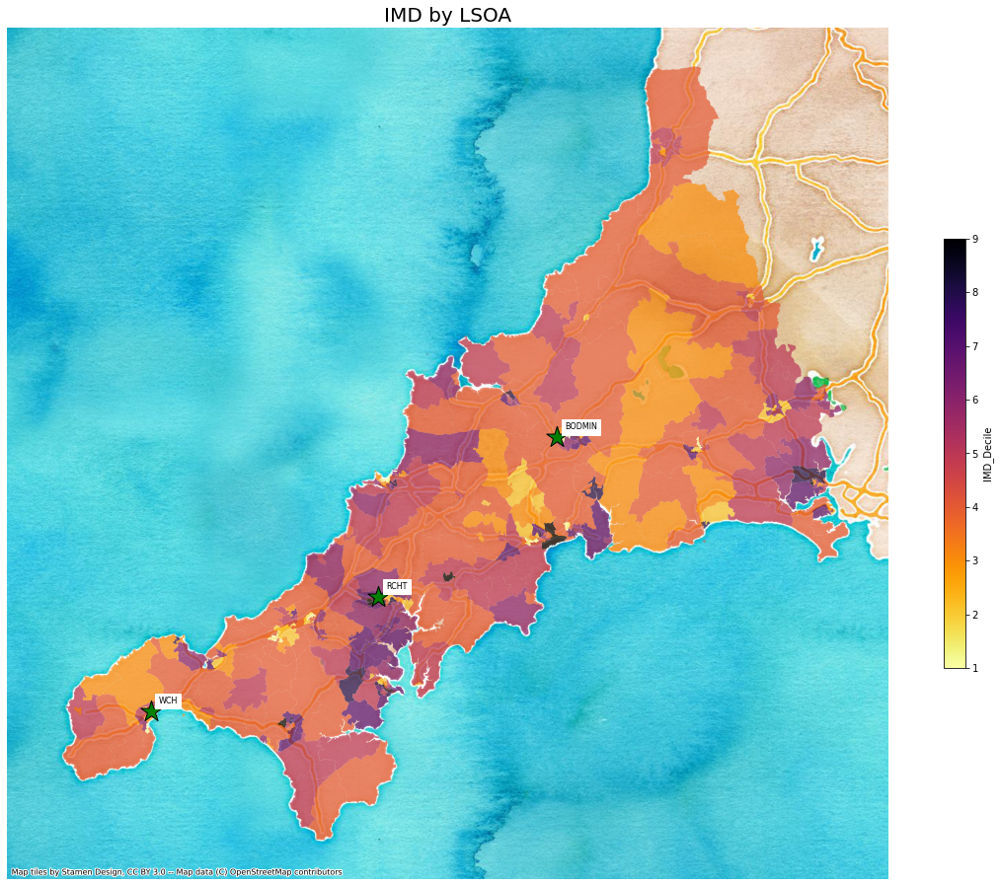

In [25]:
# create map of IMD deciles
fig, ax = plt.subplots(1, figsize=(20, 20))

gdf_cornwall_IMD_flat.plot(column='IMD_Decile',
                           cmap='inferno_r',
                           # slight transparency to see base map
                           alpha=0.70, ax=ax,
                           # include colour map legend
                           legend=True,
                           # adjust size of colourmap key, and add label
                           legend_kwds={'shrink': 0.4,
                                        'orientation': "vertical",
                                        'label': 'IMD_Decile'})

# get the best three clinics
best = tia_clinics_flat[~(tia_clinics_flat['Clinic'] == 'CRCH') & ~
                         (tia_clinics_flat['Clinic'] == 'SACH')]

# plot the 3 best clinics
ax = best.plot(ax=ax, marker='*', markersize=500, edgecolor='k', facecolor='g')

# add in labels for these clinics
for x, y, label in zip(best.geometry.x, best.geometry.y, best.Clinic):
    ax.annotate(label, xy=(x, y), xytext=(8, 8), textcoords="offset points",
                backgroundcolor="w", fontsize=8)

# add base map using contextily
ctx.add_basemap(ax,
                source=ctx.providers.Stamen.Watercolor,
                zoom=10)

# add title to the map
ax.set_title("IMD by LSOA", fontsize=20)
# remove axis
ax.set_axis_off()


<br/> It was clearly apparent that the most deprived areas (between first and third deciles) were located nearby their nearest clinic, and could therefore have quick access to those, strengthening the robustness of this final solution. Although we could spot, in the top-right of the sub-region, highly deprived LSOA (from the 3rd decile) more disadvantaged than the others 3rd decile LSOAs, according to the folium map (see 2.2.), their shortest clinic was BODMIN that we appropriately kept in this combination. Furthermore, looking at the wa_max_Q DataFrame in [10] (Section 2.1.), the 95th percentile for this BODMIN clinic (with postcode PL312QT) was 39.50, which suggested that it would take by car around 30 minutes for these areas to get to this clinic, which could still be considered acceptable.<br/><br/>

## Findings <br/>

The historical extract of data showed us that many patients were not able to drive to their nearest clinic due to their daily closure (Section 1), which exacerbated the travel time inequalities across the sub-region (seen in Section 2). Our results from Section 3 revealed that it was possible to run only three of the existing five TIA clinics together while providing fast and equitable access for patients. This was critical in view of the severity of the TIA symptoms and of the high risk of major stroke associated with this transient attack. Furthermore, the areas with a high deprivation were not particularly affected by this clinic reorganization (Section 3.2.), and the total operating cost would inherently decrease in view of this restriction in the number of available clinics in this sub-region. <br/><br/>

## Conclusions <br/>

In the course of this study, very little data were available, and especially we did not have access to any quantitative data on the quality of clinical health care, such as the rate of deaths and recoveries following the treatment of patients. This type of data would be important to consider in addition to the travel burden, to optimize the selection of clinics to maintain in this sub-region. Indeed, within the analyses, we accounted only for the car travel time to determine which combination of clinics would be the most appropriate, which was certainly not enough, in view of all the clinic care quality indicators not considered.  For that reason, we should warn the NHS commissioners team before making any final decision using our results. <br/>
Furthermore, we were unaware of the total capacity of each clinic, and the selected three clinics might not be able to meet their own increased daily demand due to the closure of the other two clinics. It would be therefore essential to take into account as well of this parameter in the selection process. <br/>
Moreover, it is possible that we were only provided with theoretical and not real car travel time data, which would be impacted by the different traffic conditions (traffic jam). This could be potentially confounding our interpretation of the results, and once again we should caution the NHS team of that limitation in their decision-making. <br/>
Assuming that patients with TIA symptoms were able to take public transport (although not necessarily realistic),  if the public transport travel time was not consistent with the car travel time data provided by the commissioners, the analysis would be skewed, and thus we would recommend the NHS team not using our results for their decision-making. <br/>
Although the total operation cost was necessarily reduced by restricting to three clinics, we were not given data on the operating cost of each clinic, which should have been considered within the analysis to assist us in the selection process. <br/>
In addition to considering higher deciles (up to 4/5), a quantitative analysis expanding the visual exploration of the IMD (Section 3.2.) would be necessary to support our findings and thus their decision-making. <br/>
Finally, conducting the analysis with more data over a longer period would have enabled us to determine with greater certainty the choice of the best three clinics.<br/><br/>